In [2]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import warnings
import math
import numpy as np
warnings.simplefilter('ignore')
import sqlite3

C:\Users\AdvancedGaming\AppData\Local\Temp\ipykernel_8228\3498668885.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [3]:
go_sales = sqlite3.connect('go_sales.sqlite')
go_sales

In [4]:
sql_query1 = "SELECT * FROM SALES_BRANCH;"
return_df = pd.read_sql(sql_query1, go_sales)

sql_query2 = "SELECT * FROM COUNTRY;"
order_df = pd.read_sql(sql_query2, go_sales)

sql_query2 = "SELECT * FROM ORDER_HEADER;"
oorder_df = pd.read_sql(sql_query2, go_sales)

sql_query2 = "SELECT * FROM SALES_STAFF;"
ooorder_df = pd.read_sql(sql_query2, go_sales)

In [5]:
join_df = pd.merge(return_df, order_df, left_on = 'COUNTRY_CODE', how = 'left', right_on="COUNTRY_CODE")
join_df

,SALES_BRANCH_CODE,ADDRESS1,ADDRESS2,CITY,REGION,POSTAL_ZONE,COUNTRY_CODE,TRIAL888,COUNTRY,LANGUAGE,CURRENCY_NAME,TRIAL879
0,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,marks,T
1,14,Leopoldstraße 36,None,München,None,D-81241,2,T,Germany,EN,marks,T
2,15,Isafjordsgatan 30 C,None,Kista,None,S-164 40,10,T,Sweden,EN,krona,T
3,17,"7800, 756 - 6th Avenue. S.W.",None,Calgary,Alberta,T2P 3Z0,4,T,Canada,EN,dollars,T
4,18,789 Yonge Street,None,Toronto,Ontario,M2M 4K8,4,T,Canada,EN,dollars,T
5,19,1288 Dorchester Avenue,None,Boston,Massachusetts,02133,3,T,United States,EN,dollars,T
6,20,299 Yale Avenue,None,Seattle,Washington,98139,3,T,United States,EN,dollars,T
7,21,1288 South Barrington Ave.,None,Los Angeles,California,90072,3,T,United States,EN,dollars,T
8,22,10032 NW 186th,None,Miami,Florida,33024,3,T,United States,EN,dollars,T
9,23,"6c, rue de l'Église",None,Lyon,None,F-69002,1,T,France,EN,francs,T


In [6]:
jjoin_df = pd.merge(join_df, oorder_df, left_on = 'SALES_BRANCH_CODE', how = 'left', right_on="SALES_BRANCH_CODE")
jjoin_df

,SALES_BRANCH_CODE,ADDRESS1,ADDRESS2,CITY,REGION,POSTAL_ZONE,COUNTRY_CODE,TRIAL888,COUNTRY,LANGUAGE,CURRENCY_NAME,TRIAL879,ORDER_NUMBER,RETAILER_NAME,RETAILER_SITE_CODE,RETAILER_CONTACT_CODE,SALES_STAFF_CODE,ORDER_DATE,ORDER_METHOD_CODE,TRIAL885
0,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,marks,T,1668,Der Fitness-Doktor,33,42,15,2020-09-18,3,T
1,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,marks,T,1669,Der Fitness-Doktor,33,42,15,2020-03-17,7,T
2,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,marks,T,1671,Der Fitness-Doktor,34,36,15,2020-04-06,1,T
3,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,marks,T,1672,Der Fitness-Doktor,35,49,15,2020-09-26,2,T
4,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,marks,T,1673,Der Fitness-Doktor,35,49,12,2020-03-29,5,T
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5355,9,Singelgravenplein 4,4e verdieping,Amsterdam,Noord-Holland,1233 BW,7,T,Netherlands,EN,guilders,T,8431,Sportworld,275,272,26,2022-12-09,4,T
5356,9,Singelgravenplein 4,4e verdieping,Amsterdam,Noord-Holland,1233 BW,7,T,Netherlands,EN,guilders,T,8432,Sportworld,272,269,23,2022-11-25,5,T
5357,9,Singelgravenplein 4,4e verdieping,Amsterdam,Noord-Holland,1233 BW,7,T,Netherlands,EN,guilders,T,8433,Sportworld,274,271,22,2022-11-22,7,T
5358,9,Singelgravenplein 4,4e verdieping,Amsterdam,Noord-Holland,1233 BW,7,T,Netherlands,EN,guilders,T,8434,Sportworld,273,270,24,2022-12-17,7,T


In [7]:
jjjoin_df = pd.merge(jjoin_df, ooorder_df, left_on = 'SALES_BRANCH_CODE', how = 'left', right_on="SALES_BRANCH_CODE")
jjjoin_df

,SALES_BRANCH_CODE,ADDRESS1,ADDRESS2,CITY,REGION,POSTAL_ZONE,COUNTRY_CODE,TRIAL888_x,COUNTRY,LANGUAGE,...,SALES_STAFF_CODE_y,FIRST_NAME,LAST_NAME,POSITION_EN,WORK_PHONE,EXTENSION,FAX,EMAIL,DATE_HIRED,TRIAL888_y
0,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,...,12,Elsbeth,Wiesinger,Level 2 Sales Representative,+(49) 40 663 1990,1818,+(49) 40 663 4571,EWiesinger@grtd123.com,27-2-2013,T
1,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,...,13,Else,Mörike,Regional Manager,+(49) 40 663 1990,1865,+(49) 40 663 4571,EMorike@grtd123.com,2-6-2015,T
2,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,...,14,Frank,Fuchs,Branch Manager,+(49) 40 663 1990,1847,+(49) 40 663 4571,FFuchs@grtd123.com,12-1-2013,T
3,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,...,15,Gunter,Erler,Level 2 Sales Representative,+(49) 40 663 1990,1823,+(49) 40 663 4571,GErler@grtd123.com,5-3-2014,T
4,13,Schwabentor 35,None,Hamburg,None,D-22529,2,T,Germany,EN,...,12,Elsbeth,Wiesinger,Level 2 Sales Representative,+(49) 40 663 1990,1818,+(49) 40 663 4571,EWiesinger@grtd123.com,27-2-2013,T
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21989,9,Singelgravenplein 4,4e verdieping,Amsterdam,Noord-Holland,1233 BW,7,T,Netherlands,EN,...,22,Belinda,Jansen-Velasquez,Level 1 Sales Representative,+31 (0)20 692 93 94,187,+31 (0)20 692 93 06,BVelasquez@grtd123.com,12-2-2015,T
21990,9,Singelgravenplein 4,4e verdieping,Amsterdam,Noord-Holland,1233 BW,7,T,Netherlands,EN,...,23,Ellen,Shapiro,Level 2 Sales Representative,+31 (0)20 692 93 94,179,+31 (0)20 692 93 06,EShapiro@grtd123.com,15-1-2015,T
21991,9,Singelgravenplein 4,4e verdieping,Amsterdam,Noord-Holland,1233 BW,7,T,Netherlands,EN,...,24,Jan,Haverkamp,Level 2 Sales Representative,+31 (0)20 692 93 94,163,+31 (0)20 692 93 06,JHaverkamp@grtd123.com,18-7-2014,T
21992,9,Singelgravenplein 4,4e verdieping,Amsterdam,Noord-Holland,1233 BW,7,T,Netherlands,EN,...,25,Kick,Kalkman,Branch Manager,+31 (0)20 692 93 94,197,+31 (0)20 692 93 06,KKalkman@grtd123.com,6-9-2011,T


In [8]:
df = jjjoin_df.loc[:, ['COUNTRY_CODE', 'CURRENCY_NAME', 'POSITION_EN', 'SALES_BRANCH_CODE']]
df

,COUNTRY_CODE,CURRENCY_NAME,POSITION_EN,SALES_BRANCH_CODE
0,2,marks,Level 2 Sales Representative,13
1,2,marks,Regional Manager,13
2,2,marks,Branch Manager,13
3,2,marks,Level 2 Sales Representative,13
4,2,marks,Level 2 Sales Representative,13
...,...,...,...,...
21989,7,guilders,Level 1 Sales Representative,9
21990,7,guilders,Level 2 Sales Representative,9
21991,7,guilders,Level 2 Sales Representative,9
21992,7,guilders,Branch Manager,9


In [9]:
df['CURRENCY_NAME'] = df['CURRENCY_NAME'].astype(str)
df.dtypes

COUNTRY_CODE         object
CURRENCY_NAME        object
POSITION_EN          object
SALES_BRANCH_CODE    object
dtype: object

In [10]:
dummies_dataframe = pd.get_dummies(df.loc[:, ['CURRENCY_NAME', 'POSITION_EN']])
dummies_dataframe

,CURRENCY_NAME_dollars,CURRENCY_NAME_francs,CURRENCY_NAME_guilders,CURRENCY_NAME_krona,CURRENCY_NAME_lira,CURRENCY_NAME_markka,CURRENCY_NAME_marks,CURRENCY_NAME_new dollar,CURRENCY_NAME_pesetas,CURRENCY_NAME_pesos,...,CURRENCY_NAME_schillings,CURRENCY_NAME_won,CURRENCY_NAME_yen,POSITION_EN_Branch Manager,POSITION_EN_District Manager,POSITION_EN_General Manager,POSITION_EN_Level 1 Sales Representative,POSITION_EN_Level 2 Sales Representative,POSITION_EN_Level 3 Sales Representative,POSITION_EN_Regional Manager
0,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,True,False,False
1,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,True
2,False,False,False,False,False,False,True,False,False,False,...,False,False,False,True,False,False,False,False,False,False
3,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,True,False,False
4,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21989,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
21990,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
21991,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
21992,False,False,True,False,False,False,False,False,False,False,...,False,False,False,True,False,False,False,False,False,False


In [11]:
df = pd.concat([df, dummies_dataframe], axis = 1)
df = df.drop(['CURRENCY_NAME', 'POSITION_EN'], axis = 1)
df = df.loc[:, ['CURRENCY_NAME_dollars', 'CURRENCY_NAME_francs', 'CURRENCY_NAME_guilders', 'CURRENCY_NAME_krona', 'CURRENCY_NAME_lira',	'CURRENCY_NAME_markka',	'CURRENCY_NAME_marks', 'CURRENCY_NAME_new dollar', 'CURRENCY_NAME_pesetas',	'CURRENCY_NAME_pesos', 'CURRENCY_NAME_pounds', 'CURRENCY_NAME_reals', 'CURRENCY_NAME_renminbi', 'CURRENCY_NAME_schillings',	'CURRENCY_NAME_won', 'CURRENCY_NAME_yen', 'POSITION_EN_Branch Manager',	'POSITION_EN_District Manager',	'POSITION_EN_General Manager', 'POSITION_EN_Level 1 Sales Representative', 'POSITION_EN_Level 2 Sales Representative', 'POSITION_EN_Level 3 Sales Representative', 'POSITION_EN_Regional Manager', 'COUNTRY_CODE', 'SALES_BRANCH_CODE']]
df

,CURRENCY_NAME_dollars,CURRENCY_NAME_francs,CURRENCY_NAME_guilders,CURRENCY_NAME_krona,CURRENCY_NAME_lira,CURRENCY_NAME_markka,CURRENCY_NAME_marks,CURRENCY_NAME_new dollar,CURRENCY_NAME_pesetas,CURRENCY_NAME_pesos,...,CURRENCY_NAME_yen,POSITION_EN_Branch Manager,POSITION_EN_District Manager,POSITION_EN_General Manager,POSITION_EN_Level 1 Sales Representative,POSITION_EN_Level 2 Sales Representative,POSITION_EN_Level 3 Sales Representative,POSITION_EN_Regional Manager,COUNTRY_CODE,SALES_BRANCH_CODE
0,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,True,False,False,2,13
1,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,True,2,13
2,False,False,False,False,False,False,True,False,False,False,...,False,True,False,False,False,False,False,False,2,13
3,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,True,False,False,2,13
4,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,True,False,False,2,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21989,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,True,False,False,False,7,9
21990,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,False,True,False,False,7,9
21991,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,False,True,False,False,7,9
21992,False,False,True,False,False,False,False,False,False,False,...,False,True,False,False,False,False,False,False,7,9


In [12]:
df_2d = df.loc[:, ['SALES_BRANCH_CODE', 'COUNTRY_CODE']]
df_2d

,SALES_BRANCH_CODE,COUNTRY_CODE
0,13,2
1,13,2
2,13,2
3,13,2
4,13,2
...,...,...
21989,9,7
21990,9,7
21991,9,7
21992,9,7


In [13]:
kmeans = KMeans(n_clusters = 3, random_state = 42)
kmeans.fit_predict(df_2d)

  File "c:\Users\AdvancedGaming\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
               ^^^^^^^^^^^^^^^
  File "c:\Users\AdvancedGaming\AppData\Local\Programs\Python\Python312\Lib\subprocess.py", line 548, in run
    with Popen(*popenargs, **kwargs) as process:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\AdvancedGaming\AppData\Local\Programs\Python\Python312\Lib\subprocess.py", line 1026, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,
  File "c:\Users\AdvancedGaming\AppData\Local\Programs\Python\Python312\Lib\subprocess.py", line 1538, in _execute_child
    hp, ht, pid, tid = _winapi.CreateProcess(executable, args,
                       ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^


array([2, 2, 2, ..., 2, 2, 2])

In [14]:
kmeans_centra = pd.DataFrame(kmeans.cluster_centers_)
kmeans_centra

,0,1
0,19.376712,3.723634
1,32.402064,12.568668
2,9.924109,3.806203


In [15]:
for i in range(len(kmeans_centra.columns)):
    kmeans_centra = kmeans_centra.rename(columns = {i : f'{df_2d.columns[i]}'})
    
kmeans_centra

,SALES_BRANCH_CODE,COUNTRY_CODE
0,19.376712,3.723634
1,32.402064,12.568668
2,9.924109,3.806203


In [16]:
for src_index, _ in df_2d.iterrows():
    euclidean_distances = dict()
    print(f"Afstand van bronindex {src_index} tot...")

    for centrumindex, _ in kmeans_centra.iterrows():
        print(f"\tCentrumindex {centrumindex}:")
        euclidean_sum = 0

        for column_name in kmeans_centra.columns:
            # Convert the string value to float before subtraction
            src_value = float(df_2d.at[src_index, column_name])
            centroid_value = kmeans_centra.at[centrumindex, column_name]
            
            # Convert the centroid value to float if necessary
            if isinstance(centroid_value, str):
                centroid_value = float(centroid_value)
                
            current_difference = src_value - centroid_value
            print(f'\t\t{src_value} - {centroid_value} = {current_difference}')
            euclidean_sum += current_difference ** 2
        
        print(f'\tTotale euclidische som: {euclidean_sum}')
        euclidean_distance = math.sqrt(euclidean_sum)
        print(f'\tEuclidische afstand: {euclidean_distance}')
        euclidean_distances[centrumindex] = euclidean_distance
        print('------------------------------------------------')
    
    print(euclidean_distances)
    centrum_number = min(euclidean_distances, key=euclidean_distances.get)
    print(centrum_number)
    df_2d.at[src_index, 'Centrum'] = centrum_number
    print("================================================")

df_2d

Afstand van bronindex 0 tot...
	Centrumindex 0:
		13.0 - 19.376712328767113 = -6.376712328767113
		2.0 - 3.723634263079714 = -1.7236342630797141
	Totale euclidische som: 43.63337519671284
	Euclidische afstand: 6.605556388126048
------------------------------------------------
	Centrumindex 1:
		13.0 - 32.40206378986842 = -19.40206378986842
		2.0 - 12.568667917448465 = -10.568667917448465
	Totale euclidische som: 488.13682085542786
	Euclidische afstand: 22.09381861189749
------------------------------------------------
	Centrumindex 2:
		13.0 - 9.92410910690691 = 3.0758908930930904
		2.0 - 3.806203255609354 = -1.8062032556093541
	Totale euclidische som: 12.72347498678684
	Euclidische afstand: 3.566998035713903
------------------------------------------------
{0: 6.605556388126048, 1: 22.09381861189749, 2: 3.566998035713903}
2
Afstand van bronindex 1 tot...
	Centrumindex 0:
		13.0 - 19.376712328767113 = -6.376712328767113
		2.0 - 3.723634263079714 = -1.7236342630797141
	Totale euclidisch

,SALES_BRANCH_CODE,COUNTRY_CODE,Centrum
0,13,2,2.0
1,13,2,2.0
2,13,2,2.0
3,13,2,2.0
4,13,2,2.0
...,...,...,...
21989,9,7,2.0
21990,9,7,2.0
21991,9,7,2.0
21992,9,7,2.0


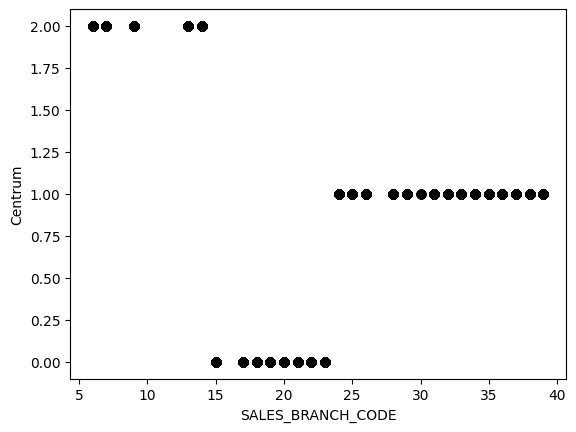

In [17]:
df_2d['SALES_BRANCH_CODE'] = pd.to_numeric(df_2d['SALES_BRANCH_CODE'])
df_2d_sorted = df_2d.sort_values(by='SALES_BRANCH_CODE', ascending=True)


plt.scatter(df_2d_sorted['SALES_BRANCH_CODE'], df_2d_sorted['Centrum'], color='k')

plt.xlabel('SALES_BRANCH_CODE')
plt.ylabel('Centrum')


plt.show()

In [18]:
df_2d.groupby('Centrum', as_index = False)['Centrum'].count()

,Centrum
0,12118
1,5330
2,4546


In [19]:
kmeans = KMeans(n_clusters = 6, random_state = 42)
prediction_results = kmeans.fit_predict(df)
prediction_results

array([2, 2, 2, ..., 4, 4, 4])

In [20]:
df['Centrum'] = prediction_results
df

,CURRENCY_NAME_dollars,CURRENCY_NAME_francs,CURRENCY_NAME_guilders,CURRENCY_NAME_krona,CURRENCY_NAME_lira,CURRENCY_NAME_markka,CURRENCY_NAME_marks,CURRENCY_NAME_new dollar,CURRENCY_NAME_pesetas,CURRENCY_NAME_pesos,...,POSITION_EN_Branch Manager,POSITION_EN_District Manager,POSITION_EN_General Manager,POSITION_EN_Level 1 Sales Representative,POSITION_EN_Level 2 Sales Representative,POSITION_EN_Level 3 Sales Representative,POSITION_EN_Regional Manager,COUNTRY_CODE,SALES_BRANCH_CODE,Centrum
0,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,True,False,False,2,13,2
1,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,True,2,13,2
2,False,False,False,False,False,False,True,False,False,False,...,True,False,False,False,False,False,False,2,13,2
3,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,True,False,False,2,13,2
4,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,True,False,False,2,13,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21989,False,False,True,False,False,False,False,False,False,False,...,False,False,False,True,False,False,False,7,9,4
21990,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,True,False,False,7,9,4
21991,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,True,False,False,7,9,4
21992,False,False,True,False,False,False,False,False,False,False,...,True,False,False,False,False,False,False,7,9,4


In [21]:
df.groupby('Centrum', as_index = False)['Centrum'].count()

,Centrum
0,10990
1,3367
2,1777
3,1963
4,2769
5,1128
